# First Network
Creating the first ALL-CIAA network with data from collaboration.csv
###### written by Nils Dyck, 18.10.2022

In [1]:
# import packages
import pandas as pd
import sys
import networkx as nx 
import matplotlib.pyplot as plt

%matplotlib inline

print(f"Python version {sys.version}")
print(f"networkx version: {nx.__version__}")

# set datapath and separation parameter
datapath = "../data/cleaned/collaboration.csv"
sep_parameter = ';'

# read data as data
data = pd.read_csv(datapath, sep = sep_parameter)

data.head()

Python version 3.9.12 (main, Apr  5 2022, 01:53:17) 
[Clang 12.0.0 ]
networkx version: 2.7.1


,Author,Title,Co-Authors,Pagination,Published in
0,Kenny Zhuo Ming Lu,Control Flow Obfuscation for FJ using Continua...,Kenny Zhuo Ming Lu,NaN,2020
1,Kenny Zhuo Ming Lu,Solving of Regular Equations Revisited.,"Martin Sulzmann, Kenny Zhuo Ming Lu",392-409,2019
2,Kenny Zhuo Ming Lu,Control flow obfuscation via CPS transformation.,Kenny Zhuo Ming Lu,54-60,2019
3,Kenny Zhuo Ming Lu,Solving of Regular Equations Revisited (extend...,"Martin Sulzmann, Kenny Zhuo Ming Lu",NaN,2019
4,Kenny Zhuo Ming Lu,Derivative-Based Diagnosis of Regular Expressi...,"Martin Sulzmann, Kenny Zhuo Ming Lu",543-562,2017


For easier use we clean up the co-author-strings a little bit.

In [2]:
co_authors = data['Co-Authors'].tolist()
for i in range(len(co_authors)):
    co_authors[i] = str(co_authors[i]).split(', ')
authors = data['Author'].tolist()
for i in range(len(co_authors)):
    for j in range(len(co_authors[i])):
        co_authors[i][j] = co_authors[i][j].replace('nan', '')
#co_authors

Let us create the co-author network graph:

In [3]:
#Initiate network-graph
G = nx.Graph()
#G.add_nodes_from(authors)
for i in range(len(authors)//10):
    for j in range(len(co_authors[i])):
        G.add_edge(authors[i], co_authors[i][j])

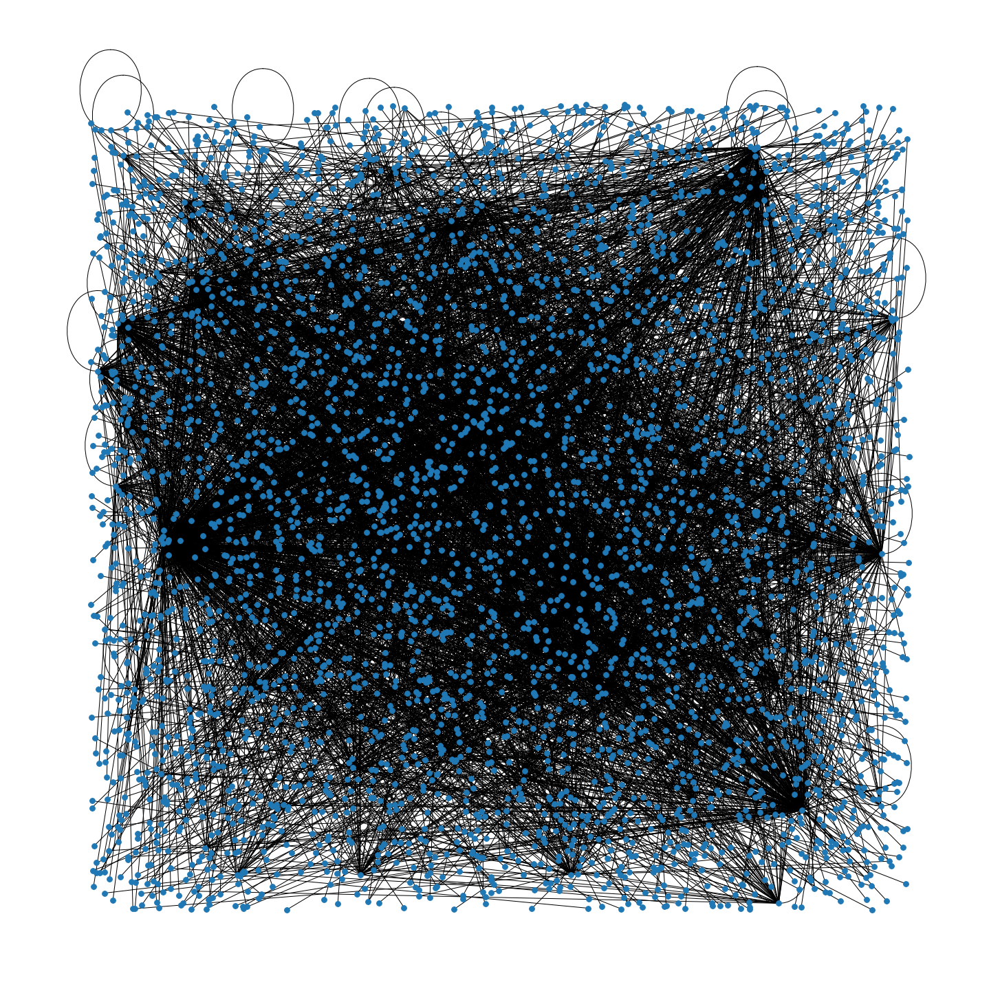

In [18]:
# larger figure size
plt.figure(3,figsize=(20,20)) 
nx.draw_random(G, node_size=60, font_size=8, with_labels = False)
#print(G.number_of_nodes())
plt.show()

In [20]:
node_sizes = dict(G.degree())
node_colors = ['r' if entry>5 else 'b' for entry in node_sizes.values()]
plt.figure(3,figsize=(100, 100)) 
nx.draw_random(G, node_size=[10 * s for s in node_sizes.values()], font_size=6, with_labels = False, node_color=node_colors, width = 0.1)
print(G.number_of_nodes())
plt.show()

3810


Let us make some statistics

In [4]:
titles = data['Title'].to_list()
papers = set(titles)
print(len(papers))

41623


Now let us work with the titles a little bit:

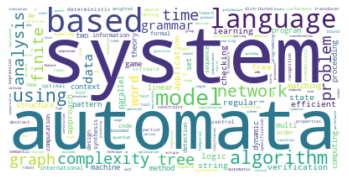

In [7]:
from wordcloud import WordCloud, STOPWORDS

title_string = ''
for paper in papers:
    title_string += (' '+str(paper))
title_string = title_string.lower()
titlecloud = WordCloud(background_color='white', collocations=False).generate(title_string)
plt.imshow(titlecloud, interpolation='bilinear')
plt.axis('off')
plt.show()